In [4]:
import altair as alt
import pandas as pd

from altair import datum
import altair.vegalite.v3 as v3

# for the notebook only (not for JupyterLab) run this command once per session
alt.renderers.enable('notebook')

RendererRegistry.enable('notebook')

In [8]:
alt.data_transformers.enable('default', max_rows=None) 

DataTransformerRegistry.enable('default')

In [9]:
# df = pd.read_csv('https://raw.githubusercontent.com/kai-wren/UCU_DataViz/master/rate.csv')
df = pd.read_csv('pitchfork.csv')
df.head()

,artist,album,genre,primary,score,date,author,role
0,David Byrne,“…The Best Live Show of All Time” — NME EP,Rock,Rock,5.5,2019-01-11,Andy Beta,Contributor
1,DJ Healer,Lost Lovesongs / Lostsongs Vol. 2,Electronic,Electronic,6.2,2019-01-11,Chal Ravens,Contributor
2,Jorge Velez,Roman Birds,Electronic,Electronic,7.9,2019-01-10,Philip Sherburne,Contributing Editor
3,Chandra,Transportation EPs,Rock,Rock,7.8,2019-01-10,Andy Beta,Contributor
4,The Chainsmokers,Sick Boy,Electronic,Electronic,3.1,2019-01-09,Larry Fitzmaurice,Contributor


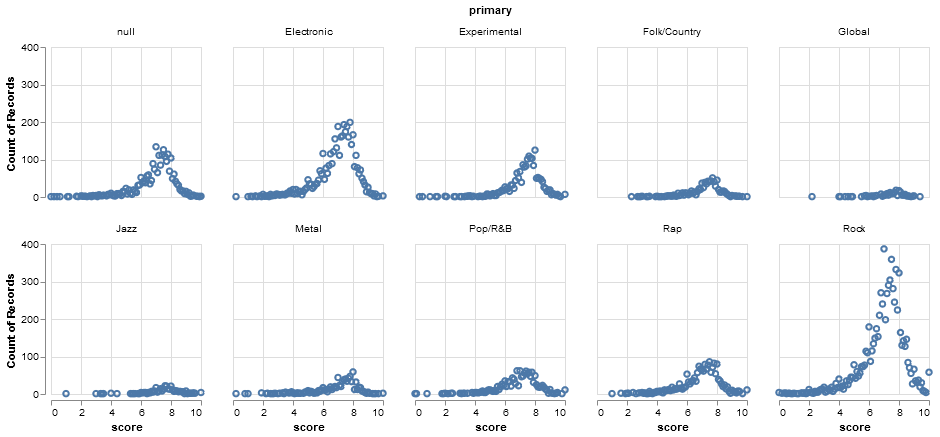

In [38]:
first = alt.Chart(df).mark_point().encode(
# x=alt.X('date:T', timeUnit='year'),
    x=alt.X('score:Q'),
    y=alt.Y('count(score):Q'),
)

first.properties(width = 150, height = 150).facet('primary', columns = 5)
#.properties(width=800, height=400)

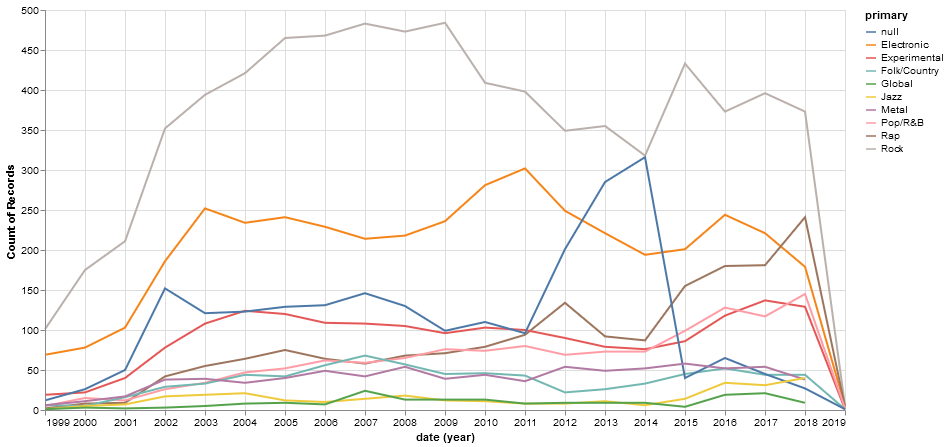

In [31]:
first = alt.Chart(df).mark_line().encode(
x=alt.X('date:T', timeUnit='year'),
    y=alt.Y('count(score):Q'),
    color=alt.Color('primary:N')
)

first.properties(width = 800, height = 400)

In [55]:
second = alt.Chart(df).mark_point().encode(
    x=alt.X('date:T', timeUnit='year'),
    y=alt.Y('artist:O', sort=alt.Sort(op='score', order='descending'))
)

second.properties(width = 800, height = 400)

TypeError: sequence item 1: expected str instance, int found

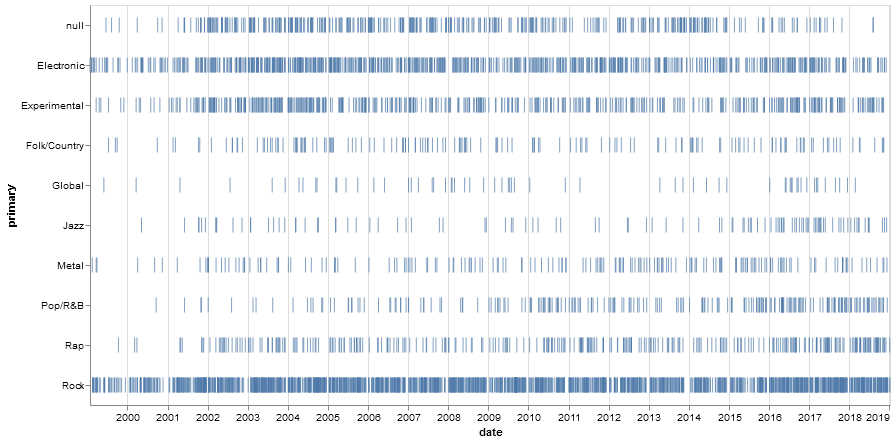

In [65]:
third = alt.Chart(df).mark_tick().encode(
    y=alt.Y('primary:O'),
    x=alt.X('date:T'),
    text=alt.Text('count():Q')
).transform_filter(datum.score >= 8)

third.properties(width=800, height=400)

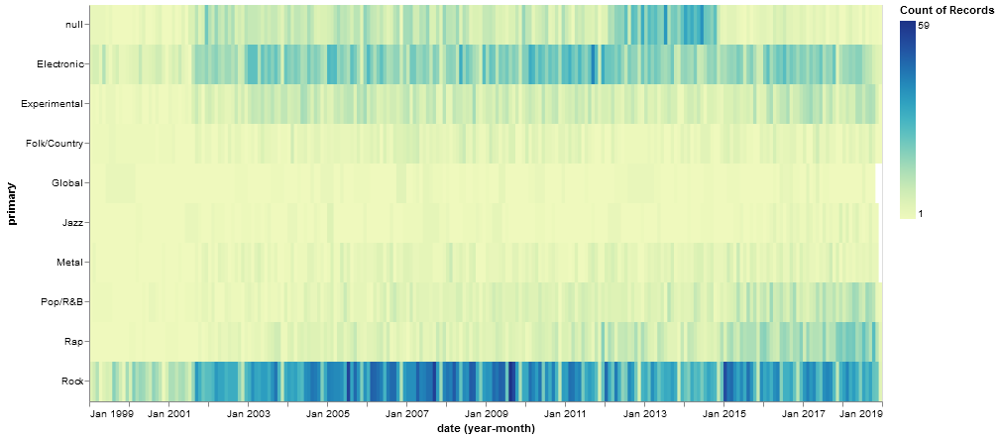

In [76]:
fourth = alt.Chart(df).mark_rect().encode(
    y=alt.Y('primary:O'),
    x=alt.X('date:T', timeUnit='yearmonth'),
    text=alt.Text('count():Q'),
    color=alt.Color('count():Q')
).transform_filter(datum.score >= 2)

fourth.properties(width=800, height=400)

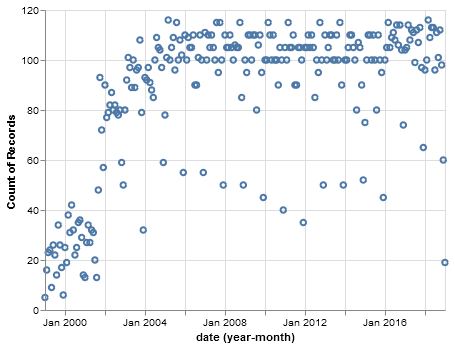

In [77]:
fifth = alt.Chart(df).mark_point().encode(
    x=alt.X('date:T', timeUnit='yearmonth'),
    y=alt.Y('count()')
)

fifth